In [1]:
cd TileEM/

In [2]:
%pylab inline
%load_ext autoreload
%autoreload 2
from TileEM_plot_toolbox import *

Populating the interactive namespace from numpy and matplotlib


In [3]:
cd output

/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM/output


In [4]:
objid=36

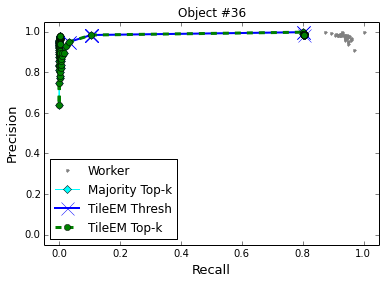

In [9]:
plot_all_postprocess_PR_curves(objid,experiment_idx=0,legend=True)

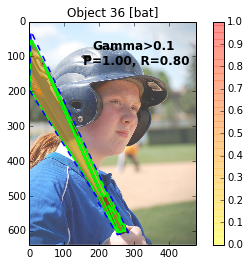

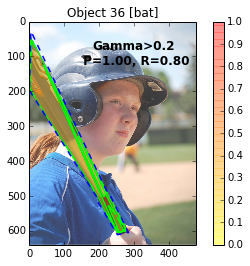

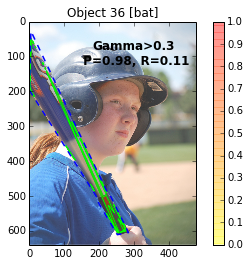

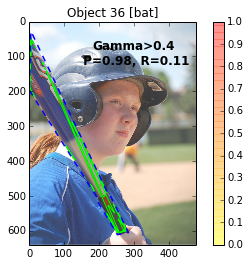

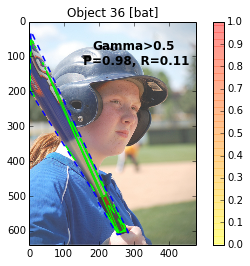

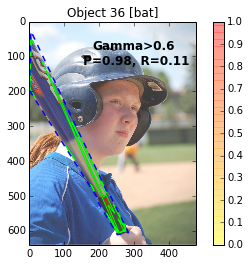

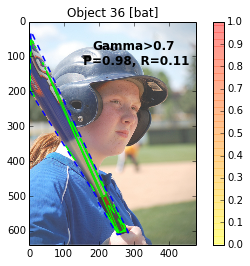

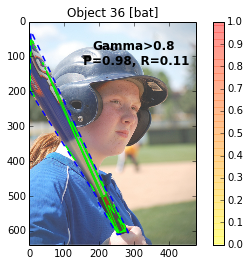

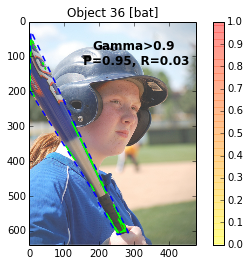

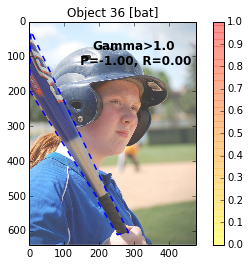

In [4]:
# Gamma threshold
threshold_lst = np.linspace(0.1,1,10)
for threshold in threshold_lst:
    p,r = compute_PR_obj(objid,0,threshold=threshold,PLOT_HEATMAP=True)

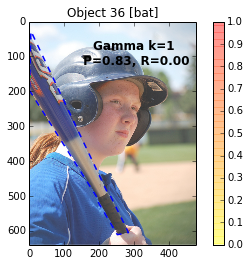

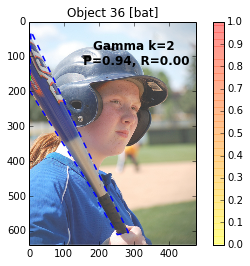

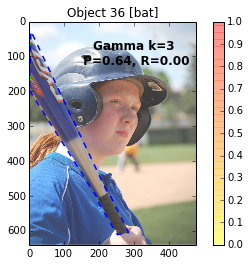

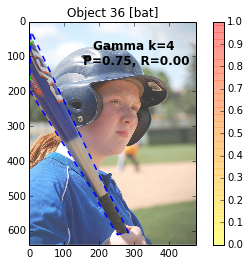

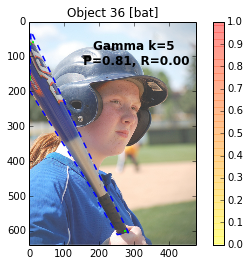

...

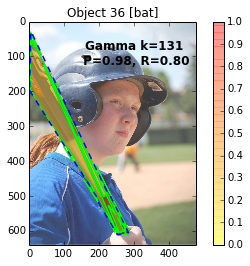

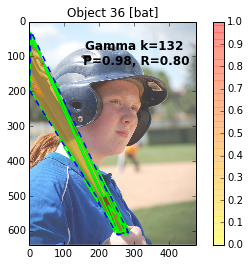

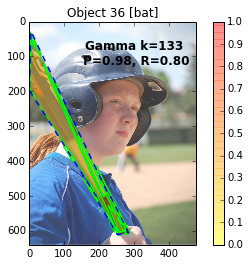

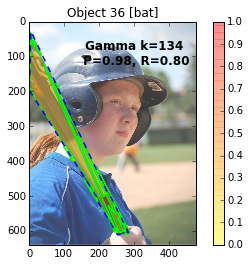

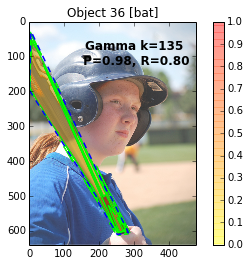

In [5]:
DATA_DIR='output'
os.chdir("..")
tiles, objIndicatorMat = createObjIndicatorMatrix(objid, PRINT=False)
os.chdir(DATA_DIR)
k_lst = np.arange(1,len(tiles),10)
for k in tqdm(k_lst):
    p,r = compute_PR_obj(objid,0,topk=k,PLOT_HEATMAP=True)

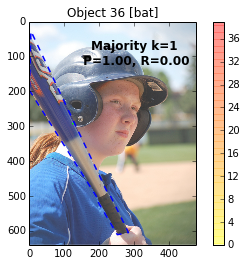

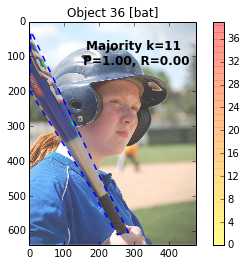

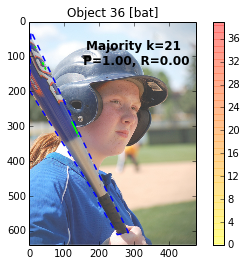

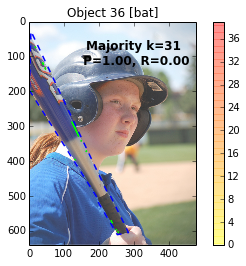

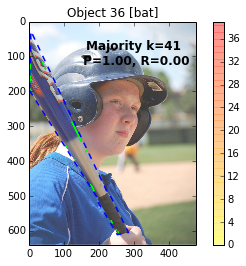

...

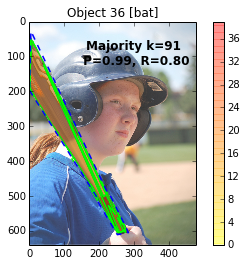

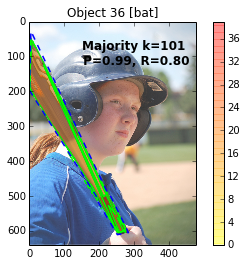

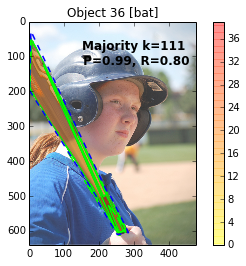

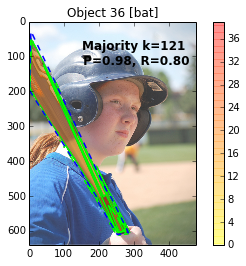

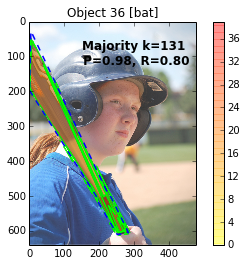

In [10]:
k_lst = np.arange(1,len(tiles),10)
for k in tqdm(k_lst):
    p,r = compute_PR_obj(objid,0,majority_topk=k,PLOT_HEATMAP='all-regions')

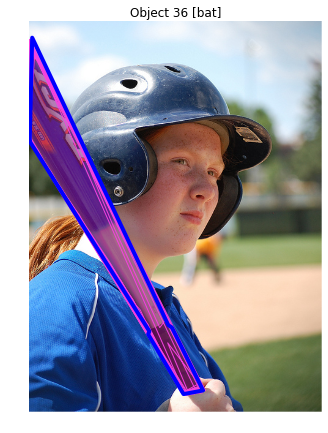

In [12]:
os.chdir("../../")
visualize_bb_objects(objid)

In [11]:
import mpld3
mpld3.enable_notebook()
mpld3.disable_notebook()

[  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.  14.
  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.]


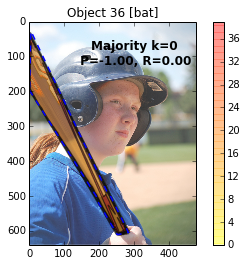

In [5]:
p,r = compute_PR_obj(objid,0,majority_topk=0,PLOT_HEATMAP='all-region')

[  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.  14.
  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.]
Object  23
Check that there are no all-zero rows in indicator matrix: True
Check that there are no all-zero columns in indicator matrix: True


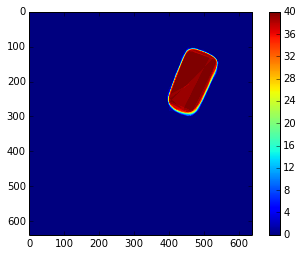

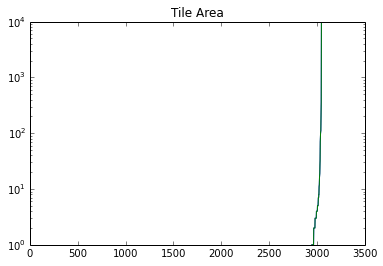

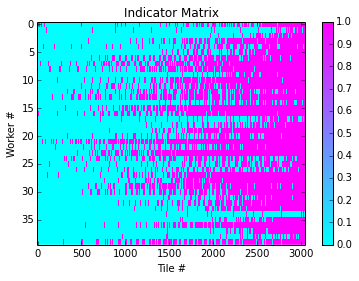

In [8]:
tiles,indicator_matrix = createObjIndicatorMatrix(23,PLOT=True)

[  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.  14.
  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.  28.  29.
  30.  31.  32.  33.  34.  35.  36.]
Object  22
Check that there are no all-zero rows in indicator matrix: True
Check that there are no all-zero columns in indicator matrix: True


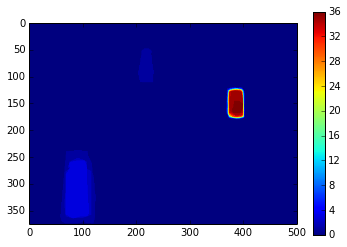

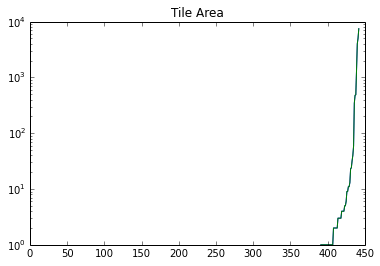

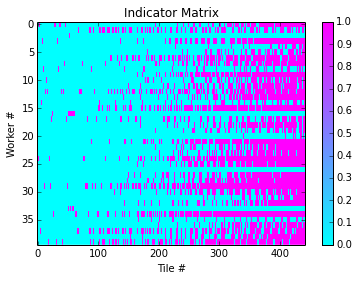

In [7]:
os.chdir("../")
tiles,indicator_matrix = createObjIndicatorMatrix(22,PLOT=True)

Object  36
Check that there are no all-zero rows in indicator matrix: True
Check that there are no all-zero columns in indicator matrix: True


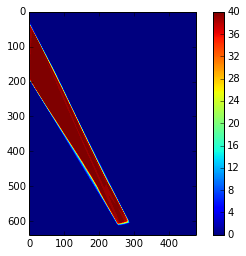

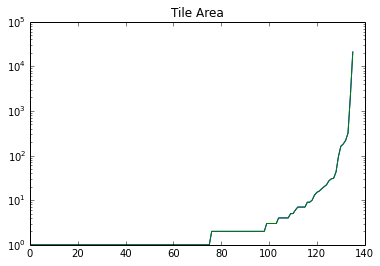

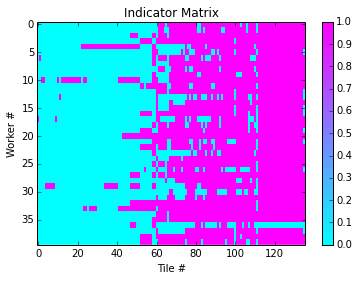

In [13]:
os.chdir("../")
tiles,indicator_matrix = createObjIndicatorMatrix(objid,PLOT=True)

This is missing a few counts if you compare the votes that you get from the indicator matrix versus the majority vote computed from the heatmap shown in createObjIndicatorMat, the central region should always have the highest vote. This doesnt make sense, there must be a bug either in the createObjIndicatorMat code or the tile heatmap plotting code. Most likely the former 

In [11]:
tile_votes = np.sum(indicator_matrix[:-1],axis=0)

In [12]:
tile_votes

array([ 1,  1,  1, ..., 36, 36, 38])

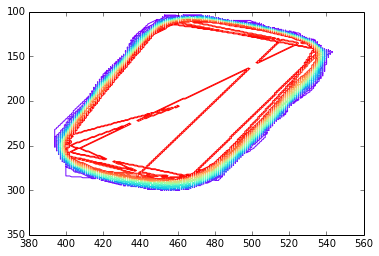

In [10]:
plot_all_tiles(tiles)

If I turn off the if tile.area>=1 constraint, then I get thousands of tiles

tiles,indicator_matrix = createObjIndicatorMatrix(objid,PLOT=True)

In [83]:
mpld3.disable_notebook()

Object  36
Check that there are no all-zero rows in indicator matrix: True
Check that there are no all-zero columns in indicator matrix: True


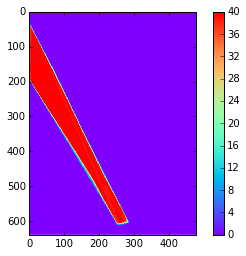

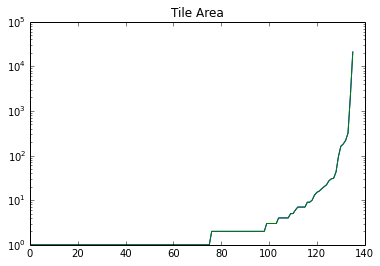

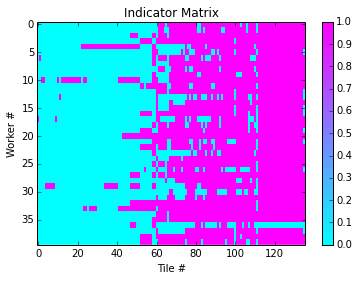

In [87]:
tiles,indicator_matrix = createObjIndicatorMatrix(objid,PLOT=True)

all unvoted tiles: []
all unvoted workers: []
Object  36
Check that there are no all-zero rows in indicator matrix: True
Check that there are no all-zero columns in indicator matrix: True


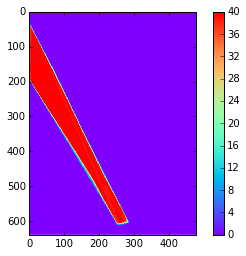

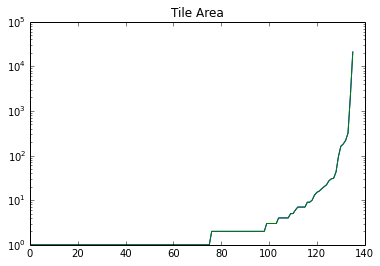

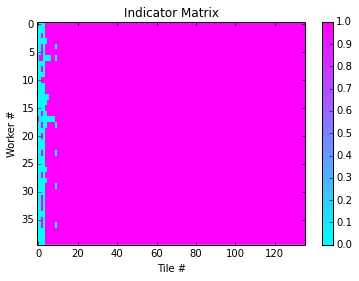

In [88]:
tiles,indicator_matrix = createObjIndicatorMatrix(objid,PLOT=True)

all unvoted tiles: [ 0  1  2  3  4  5  6  7  8  9 10 11 18 19 20 21 23 24 25 26 27 28 29]
all unvoted workers: []
Object  36
Check that there are no all-zero rows in indicator matrix: True
Check that there are no all-zero columns in indicator matrix: True


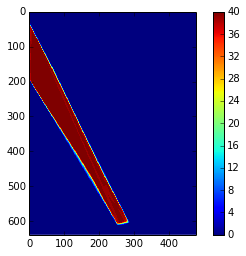

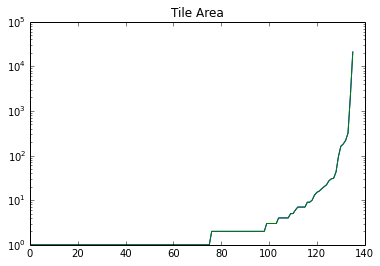

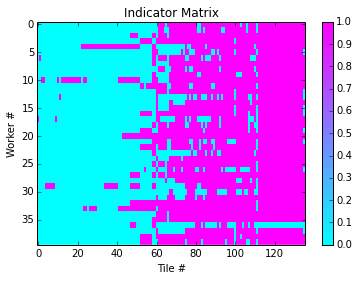

In [93]:
tiles,indicator_matrix = createObjIndicatorMatrix(objid,PLOT=True)

In [89]:
def plot_all_tiles_with_votes(tiles,votes):
    levels=np.arange(0,max(votes)+1)
    colors=cm.rainbow(levels)
    Z = [[0,0],[0,0]] 
    CS3 = plt.contourf(Z, levels, cmap=cm.rainbow)
    plt.clf()
    plt.figure()
    for tile,v in zip(tiles[::-1],votes[::-1]):
        plot_coords(Polygon(tile),color=colors[v],fill_color=colors[v])
    plt.gca().invert_yaxis()
    plt.colorbar(CS3)

In [90]:
import mpld3
mpld3.enable_notebook()
mpld3.disable_notebook()

In [91]:
tile_votes

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  3,  3,  1,  2,  2,  2,  2,  1,  1,  1,  1,
        2,  2,  2,  2,  2,  2,  2,  3,  3,  4,  4,  4,  4,  9,  9,  9,  8,
        7, 10, 10, 10, 10, 10, 10, 20, 20, 20, 23, 22, 22, 21, 18, 13, 27,
       31, 28, 30, 30, 30, 29, 30, 31, 35, 31, 34, 36, 35, 33, 32, 33, 32,
       31, 37, 37, 34, 35, 39, 36, 33, 36, 38, 37, 37, 37, 37, 37, 28, 37,
       37, 34, 38, 38, 35, 32, 35, 38, 33, 17, 39, 39, 39, 39, 39, 39, 39,
       39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 30])

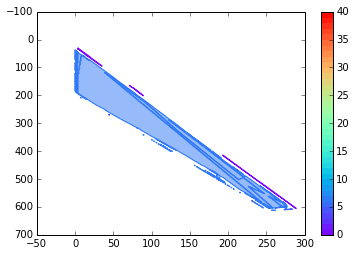

In [92]:
tile_votes = np.sum(indicator_matrix[:-1],axis=0)
plot_all_tiles_with_votes(tiles,tile_votes)

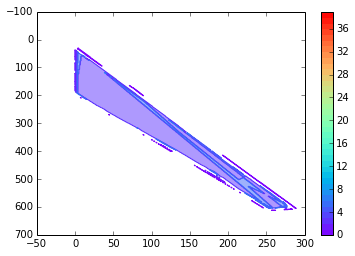

In [79]:
tile_votes = np.sum(indicator_matrix[:-1],axis=0)
plot_all_tiles_with_votes(tiles,tile_votes)

print everything that voted for one tile and see if they do look right

In [149]:
tidx=100
tile = tiles[tidx]

In [150]:
worker_idxs = np.where(indicator_matrix[:,tidx][:-1]==1)[0]

In [151]:
worker_idxs

array([ 0,  1,  2,  4,  6,  7,  8,  9, 10, 11, 14, 17, 18, 19, 20, 22, 23,
       24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35])

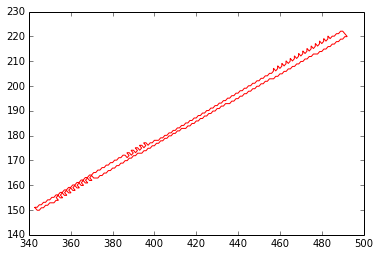

In [152]:
plot_coords(Polygon(zip(tile[:,1],tile[:,0])))

In [180]:
def plot_worker(object_id,worker_id):
    bb_objects = bb_info[bb_info["object_id"]==object_id]
    worker_lst  = np.unique(bb_objects.worker_id)
    bb = bb_objects[bb_objects["worker_id"]==worker_lst[worker_id]]
    xloc,yloc =  process_raw_locs([bb["x_locs"].iloc[0],bb["y_locs"].iloc[0]])    
    plt.plot(xloc,yloc,'-',color='blue',linewidth=0.5)
#     plt.fill_between(xloc,yloc,color='none',facecolor='cyan', alpha=0.5)

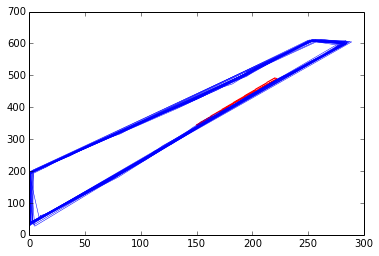

In [181]:
for wid in worker_idxs:
    plot_worker(objid,worker_id=wid)
plot_coords(Polygon(tile))

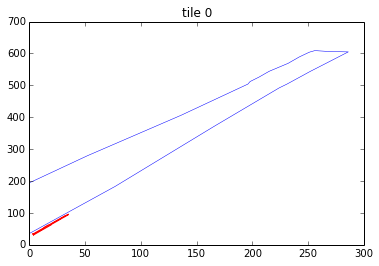

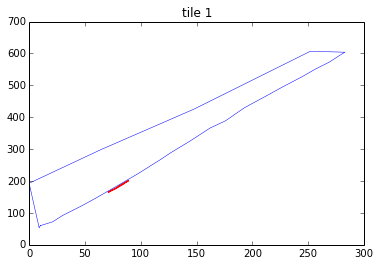

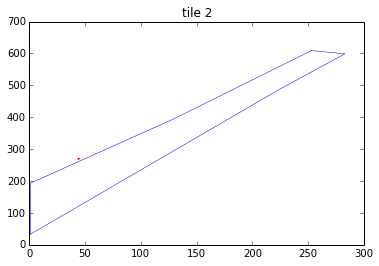

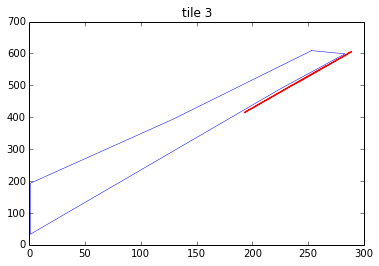

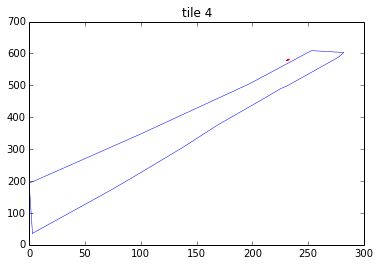

...

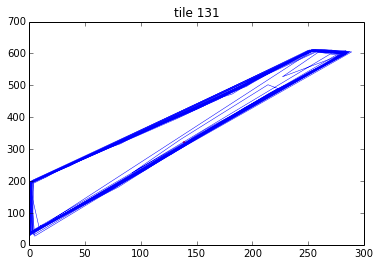

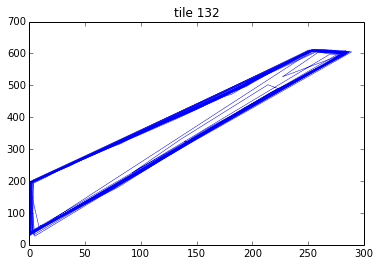

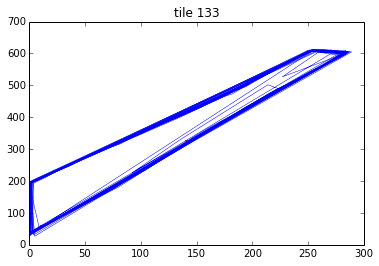

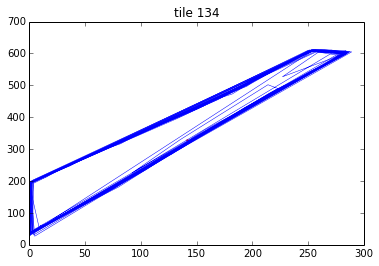

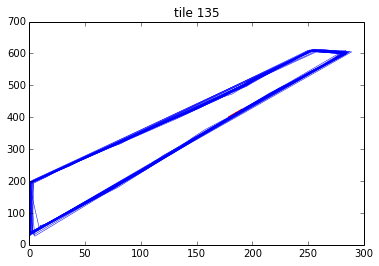

In [183]:
for tidx in range(len(tiles)):
    plt.figure()
    plt.title("tile {}".format(tidx))
    tile = tiles[tidx]
    worker_idxs = np.where(indicator_matrix[:,tidx][:-1]==1)[0]
    for wid in worker_idxs:
        plot_worker(objid,worker_id=wid)
    plot_coords(Polygon(tile))